# 🌍 **Estudio de la actividad sísmica global en 2023 mediante modelos de machine learning y redes neuronales** 🖥️

## 📝 **Contexto**

### Los terremotos son desastres naturales que provocan efectos catastróficos en la población y las infraestructuras. Predecir con exactitud cúando y dónde ocurrirán es una tarea difícil. Desarrollar modelos predictivos es vital para minimizar los impactos de los seísmos que ocurren frecuentemente en algunas zonas del planeta. Estudiar y entender los patrones y la relación de distintas variables pueden ayudar a predecir los seísmos y de esta manera desarrollar estrategias efectivas para mitigar los efectos que ocasionan.
### Existen numerosos estudios sobre el uso de modelos de machine learning y también de deep learning que pueden predecir la magnitud de los terremotos, y es importante mejorar los modelos y conseguir información relevante que pueda ayudar a crear mejores predicciones. Por esto, el estudio sobre los terremotos ocurridos en 2023 y la comparación de los distintos modelos puede ayudar a su predicción.

## 📊 **Columnas del dataset (inglés)**

1. **Time**: Timestamp of the earthquake event.
2. **Latitude**: Geographic coordinate specifying the north-south position.
3. **Longitude**: Geographic coordinate specifying the east-west position.
4. **Depth**: Depth of the earthquake in kilometers.
5. **Mag**: Magnitude of the earthquake.
6. **MagType**: Type of magnitude measurement.
7. **Nst**: Number of seismic stations reporting the earthquake.
8. **Gap**: Gap between seismic stations' coverage.
9. **Dmin**: Minimum distance to the earthquake epicenter for the nearest station.
10. **Rms**: Root Mean Square of the earthquake's amplitude spectrum.
11. **Net**: Network reporting the earthquake.
12. **Id**: Unique identifier for the earthquake event.
13. **Updated**: Timestamp for the earthquake information's last update.
14. **Place**: Location description of the earthquake.
15. **Type**: Type of seismic event (e.g., earthquake).
16. **HorizontalError**: Horizontal error in location determination.
17. **DepthError**: Error in depth determination.
18. **MagError**: Error in magnitude determination.
19. **MagNst**: Number of seismic stations used to calculate the magnitude.
20. **Status**: Status of the earthquake event (e.g., reviewed).
21. **LocationSource**: Source reporting the earthquake location.
22. **MagSource**: Source reporting the earthquake magnitude. 

# 📚 **Librerías, fuente de datos y limpieza de los datos** 🗑️

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/earthquakes-2023-global/earthquakes_2023_global.csv


In [4]:
df = pd.read_csv('/kaggle/input/earthquakes-2023-global/earthquakes_2023_global.csv')

## 🗑️ **Limpieza de datos**

### **Vista preeliminar del contenido de los datos y el tipo de información que contienen:**

In [5]:
df.head(10)

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,2023-01-01T00:49:25.294Z,52.099900,178.521800,82.770,3.10,ml,14.0,139.0,0.87000,0.18,...,2023-03-11T22:51:52.040Z,"Rat Islands, Aleutian Islands, Alaska",earthquake,8.46,21.213,0.097,14.0,reviewed,us,us
1,2023-01-01T01:41:43.755Z,7.139700,126.738000,79.194,4.50,mb,32.0,104.0,1.15200,0.47,...,2023-03-11T22:51:45.040Z,"23 km ESE of Manay, Philippines",earthquake,5.51,7.445,0.083,43.0,reviewed,us,us
2,2023-01-01T03:29:31.070Z,19.163100,-66.525100,24.000,3.93,md,23.0,246.0,0.84790,0.22,...,2023-03-11T22:51:29.040Z,Puerto Rico region,earthquake,0.91,15.950,0.090,16.0,reviewed,pr,pr
3,2023-01-01T04:09:32.814Z,-4.780300,102.767500,63.787,4.30,mb,17.0,187.0,0.45700,0.51,...,2023-03-11T22:51:45.040Z,"99 km SSW of Pagar Alam, Indonesia",earthquake,10.25,6.579,0.238,5.0,reviewed,us,us
4,2023-01-01T04:29:13.793Z,53.396500,-166.941700,10.000,3.00,ml,19.0,190.0,0.40000,0.31,...,2023-03-11T22:51:38.040Z,"59 km SSW of Unalaska, Alaska",earthquake,1.41,1.999,0.085,18.0,reviewed,us,us
5,2023-01-01T04:50:17.639Z,19.281100,-155.428200,37.751,2.80,ml,19.0,127.0,0.06600,0.18,...,2023-03-11T22:51:29.040Z,"10 km NNE of P?hala, Hawaii",earthquake,2.77,5.266,0.060,36.0,reviewed,us,us
6,2023-01-01T04:54:53.914Z,-19.041900,-177.542300,556.990,4.10,mb,15.0,87.0,3.05100,0.15,...,2023-03-11T22:51:45.040Z,Fiji region,earthquake,12.85,13.028,0.213,6.0,reviewed,us,us
7,2023-01-01T05:02:46.402Z,-15.321900,-174.875600,255.470,4.10,mb,40.0,81.0,3.41300,0.32,...,2023-03-11T22:51:45.040Z,Tonga,earthquake,9.84,6.047,0.095,34.0,reviewed,us,us
8,2023-01-01T05:18:17.780Z,40.703833,-124.206167,18.470,2.70,md,30.0,154.0,0.01251,0.14,...,2023-04-05T16:43:13.238Z,"3km SSW of Humboldt Hill, CA",earthquake,0.41,0.280,0.112,35.0,reviewed,nc,nc
9,2023-01-01T05:37:05.794Z,2.475200,128.638900,231.588,4.10,mb,27.0,119.0,2.11700,0.45,...,2023-03-11T22:51:45.040Z,"108 km NE of Tobelo, Indonesia",earthquake,7.94,9.269,0.123,18.0,reviewed,us,us


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26642 entries, 0 to 26641
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   time             26642 non-null  object 
 1   latitude         26642 non-null  float64
 2   longitude        26642 non-null  float64
 3   depth            26642 non-null  float64
 4   mag              26642 non-null  float64
 5   magType          26642 non-null  object 
 6   nst              25227 non-null  float64
 7   gap              25225 non-null  float64
 8   dmin             24776 non-null  float64
 9   rms              26642 non-null  float64
 10  net              26642 non-null  object 
 11  id               26642 non-null  object 
 12  updated          26642 non-null  object 
 13  place            25034 non-null  object 
 14  type             26642 non-null  object 
 15  horizontalError  25093 non-null  float64
 16  depthError       26642 non-null  float64
 17  magError    

In [7]:
df.describe(include='all')

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
count,26642,26642.000000,26642.000000,26642.000000,26642.000000,26642,25227.000000,25225.000000,24776.000000,26642.000000,...,26642,25034,26642,25093.000000,26642.000000,24970.000000,25065.000000,26642,26642,26642
unique,24682,NaN,NaN,NaN,NaN,15,NaN,NaN,NaN,NaN,...,7847,14811,8,NaN,NaN,NaN,NaN,2,16,19
top,2023-04-06T01:08:20.773Z,NaN,NaN,NaN,NaN,mb,NaN,NaN,NaN,NaN,...,2023-10-17T22:01:29.040Z,"Izu Islands, Japan region",earthquake,NaN,NaN,NaN,NaN,reviewed,us,us
freq,2,NaN,NaN,NaN,NaN,15906,NaN,NaN,NaN,NaN,...,97,358,26428,NaN,NaN,NaN,NaN,26566,21409,21249
mean,NaN,16.852798,-11.487497,67.491224,4.007395,NaN,42.571332,124.930971,2.692908,0.581575,...,NaN,NaN,NaN,7.017267,4.475056,0.122735,33.315939,NaN,NaN,NaN
std,NaN,30.389200,130.053399,116.762456,0.794423,NaN,37.662352,67.430145,4.043568,0.256276,...,NaN,NaN,NaN,4.072365,4.451649,0.102271,48.022567,NaN,NaN,NaN
min,NaN,-65.849700,-179.998700,-3.370000,2.600000,NaN,0.000000,8.000000,0.000000,0.010000,...,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN
25%,NaN,-6.415275,-149.608650,10.000000,3.220000,NaN,19.000000,73.000000,0.612000,0.410000,...,NaN,NaN,NaN,4.140000,1.848000,0.080000,10.000000,NaN,NaN,NaN
50%,NaN,18.884167,-64.811833,21.998000,4.300000,NaN,30.000000,111.000000,1.579000,0.590000,...,NaN,NaN,NaN,7.060000,2.019000,0.111000,18.000000,NaN,NaN,NaN
75%,NaN,41.827950,126.965100,66.833000,4.500000,NaN,52.000000,165.000000,3.172000,0.750000,...,NaN,NaN,NaN,9.730000,6.669000,0.150000,36.000000,NaN,NaN,NaN


### **Eliminación de valores nulos y duplicados:**

In [8]:
# Explorar valores nulos
df.isnull().sum()

time                  0
latitude              0
longitude             0
depth                 0
mag                   0
magType               0
nst                1415
gap                1417
dmin               1866
rms                   0
net                   0
id                    0
updated               0
place              1608
type                  0
horizontalError    1549
depthError            0
magError           1672
magNst             1577
status                0
locationSource        0
magSource             0
dtype: int64

In [9]:
# Eliminar filas con valores nulos
df.dropna(subset=['nst', 'gap', 'dmin', 'place', 'horizontalError', 'magError', 'magNst'], inplace=True)

In [10]:
# Explorar total de valores duplicados
duplicados = df[df.duplicated()]
print("Número total duplicados: ", len(duplicados))

Número total duplicados:  1788


In [11]:
# Eliminar duplicados
df.drop_duplicates()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,2023-01-01T00:49:25.294Z,52.0999,178.5218,82.770,3.10,ml,14.0,139.0,0.8700,0.18,...,2023-03-11T22:51:52.040Z,"Rat Islands, Aleutian Islands, Alaska",earthquake,8.46,21.213,0.097,14.0,reviewed,us,us
1,2023-01-01T01:41:43.755Z,7.1397,126.7380,79.194,4.50,mb,32.0,104.0,1.1520,0.47,...,2023-03-11T22:51:45.040Z,"23 km ESE of Manay, Philippines",earthquake,5.51,7.445,0.083,43.0,reviewed,us,us
2,2023-01-01T03:29:31.070Z,19.1631,-66.5251,24.000,3.93,md,23.0,246.0,0.8479,0.22,...,2023-03-11T22:51:29.040Z,Puerto Rico region,earthquake,0.91,15.950,0.090,16.0,reviewed,pr,pr
3,2023-01-01T04:09:32.814Z,-4.7803,102.7675,63.787,4.30,mb,17.0,187.0,0.4570,0.51,...,2023-03-11T22:51:45.040Z,"99 km SSW of Pagar Alam, Indonesia",earthquake,10.25,6.579,0.238,5.0,reviewed,us,us
4,2023-01-01T04:29:13.793Z,53.3965,-166.9417,10.000,3.00,ml,19.0,190.0,0.4000,0.31,...,2023-03-11T22:51:38.040Z,"59 km SSW of Unalaska, Alaska",earthquake,1.41,1.999,0.085,18.0,reviewed,us,us
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26637,2023-12-29T03:37:19.334Z,-6.9527,154.9829,10.000,5.20,mb,72.0,60.0,3.9240,0.93,...,2023-12-29T04:05:57.040Z,"89 km SW of Panguna, Papua New Guinea",earthquake,10.07,1.765,0.048,141.0,reviewed,us,us
26638,2023-12-29T04:38:54.109Z,32.3262,141.7386,10.000,5.10,mb,74.0,121.0,1.8030,0.70,...,2023-12-29T10:59:44.533Z,"Izu Islands, Japan region",earthquake,9.17,1.870,0.042,187.0,reviewed,us,us
26639,2023-12-29T08:42:05.747Z,-7.2411,68.0663,10.000,5.10,mb,60.0,54.0,12.7760,0.57,...,2023-12-29T08:57:05.040Z,Chagos Archipelago region,earthquake,8.02,1.792,0.090,40.0,reviewed,us,us
26640,2023-12-29T11:02:48.679Z,-19.1602,169.0428,153.264,4.70,mb,40.0,61.0,3.7460,0.82,...,2023-12-29T11:22:46.040Z,"49 km NNW of Isangel, Vanuatu",earthquake,8.52,7.433,0.081,46.0,reviewed,us,us


### **Eliminación filas con datos igual a 0 en las columnas _nst_ y _magNst_**

In [12]:
# Eliminar filas donde 'nst' y 'magNst' sean iguales a 0
df = df.loc[(df['nst'] != 0) & (df['magNst'] != 0)] 

### **Cambiar el tipo de dato de la columna 'time' para mejorar los análisis posteriores:**

In [13]:
# Cambiar tipo de dato en la columna "time"
df['time'] = pd.to_datetime(df['time'])

# 📊 **EDA (Análisis exploratorio de los datos)**
## **1. Análisis de la magnitud, profundidad y el tipo de seísmos**
### **Analizamos la frecuencia de los seísmos según el tipo de seísmo:** 

In [14]:
# Tipos de seísmo
df['type'].unique()

array(['earthquake', 'mining explosion', 'ice quake', 'quarry blast',
       'volcanic eruption', 'explosion'], dtype=object)

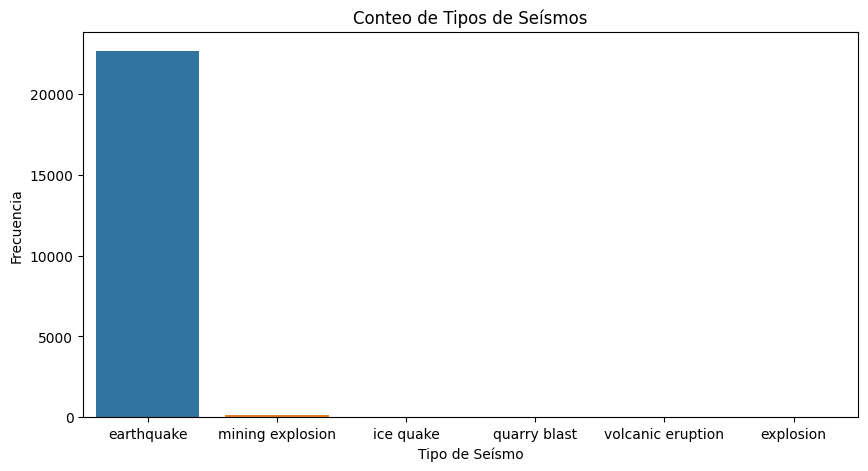

In [15]:
# Gráfico de barras tipo de seísmos
plt.figure(figsize=(10, 5))
sns.countplot(x='type', data=df)
plt.title('Conteo de Tipos de Seísmos')
plt.xlabel('Tipo de Seísmo')
plt.ylabel('Frecuencia')
plt.show()

In [16]:
# Dataframe con el núméro de seísmos de cada tipo
conteo_type = df['type'].value_counts()
df_conteo_type = pd.DataFrame({'Type': conteo_type.index, 'Frecuencia': conteo_type.values})
df_conteo_type

,Type,Frecuencia
0,earthquake,22691
1,mining explosion,159
2,volcanic eruption,13
3,ice quake,1
4,quarry blast,1
5,explosion,1


### **Seísmos que no son causados por el movimiento de placas:**

In [17]:
df.loc[df['type']=='mining explosion']

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
115,2023-01-02 19:02:17.679000+00:00,43.8095,-105.2956,0.0,3.3,ml,14.0,83.0,0.962,0.49,...,2023-03-11T22:51:33.040Z,"17 km ENE of Wright, Wyoming",mining explosion,7.53,1.674,0.050,52.0,reviewed,us,us
245,2023-01-04 18:04:26.544000+00:00,47.5257,-92.5739,0.0,2.8,ml,9.0,106.0,1.155,1.00,...,2023-03-11T22:51:50.040Z,"0 km SSE of Parkville, Minnesota",mining explosion,3.80,1.879,0.115,10.0,reviewed,us,us
246,2023-01-04 18:59:38.592000+00:00,43.6984,-105.3634,0.0,3.4,ml,18.0,71.0,1.048,0.82,...,2023-03-11T22:51:39.040Z,"11 km ESE of Wright, Wyoming",mining explosion,4.49,0.979,0.045,64.0,reviewed,us,us
324,2023-01-06 18:25:44.843000+00:00,47.5429,-92.7329,0.0,3.0,ml,25.0,79.0,0.928,1.00,...,2023-03-11T22:51:43.040Z,"3 km N of Kinney, Minnesota",mining explosion,4.93,1.951,0.105,12.0,reviewed,us,us
335,2023-01-06 21:34:44.291000+00:00,43.7374,-105.2726,0.0,3.4,ml,22.0,71.0,0.972,0.72,...,2023-03-11T22:51:43.040Z,Wyoming,mining explosion,5.85,1.760,0.043,72.0,reviewed,us,us
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15567,2023-10-16 21:00:29.905000+00:00,45.0540,-106.6866,0.0,2.9,ml,19.0,104.0,1.667,0.91,...,2023-12-26T21:24:26.040Z,"32 km SSW of Birney, Montana",mining explosion,3.29,1.820,0.066,46.0,reviewed,us,us
15611,2023-10-17 21:12:56.104000+00:00,43.6162,-105.1993,0.0,3.1,ml,26.0,98.0,0.981,1.22,...,2023-12-26T21:24:47.040Z,"27 km ESE of Wright, Wyoming",mining explosion,7.29,1.922,0.059,38.0,reviewed,us,us
15661,2023-10-18 19:04:01.715000+00:00,45.0737,-106.7599,0.0,3.0,ml,50.0,67.0,1.658,0.86,...,2023-12-26T21:24:34.040Z,"33 km SW of Birney, Montana",mining explosion,3.69,1.777,0.041,80.0,reviewed,us,us
15666,2023-10-18 20:57:19.050000+00:00,43.7789,-105.3012,0.0,3.2,ml,29.0,60.0,0.976,0.54,...,2023-12-26T21:24:35.040Z,"15 km E of Wright, Wyoming",mining explosion,5.13,1.461,0.045,64.0,reviewed,us,us


In [18]:
df.loc[df['type']=='volcanic eruption']

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
13860,2023-09-14 15:48:26.701000+00:00,15.4692,146.1768,10.000,4.5,mb,13.0,194.0,0.439,0.78,...,2023-11-18T22:29:31.040Z,"53 km ENE of Saipan, Northern Mariana Islands",volcanic eruption,5.96,1.914,0.272,4.0,reviewed,us,us
13883,2023-09-15 04:26:31.134000+00:00,15.4105,145.4988,10.000,4.2,mb,13.0,102.0,0.332,0.60,...,2023-11-18T22:29:31.040Z,"35 km NW of Saipan, Northern Mariana Islands",volcanic eruption,6.40,1.900,0.167,11.0,reviewed,us,us
13890,2023-09-15 07:25:40.633000+00:00,15.4528,145.9570,10.289,4.4,mb,19.0,120.0,2.132,0.73,...,2023-11-18T22:29:31.040Z,"34 km NE of Saipan, Northern Mariana Islands",volcanic eruption,5.80,5.072,0.149,13.0,reviewed,us,us
13891,2023-09-15 07:28:50.217000+00:00,15.4575,145.7466,10.405,4.5,mb,19.0,121.0,0.227,0.64,...,2023-11-18T22:29:31.040Z,"27 km N of Saipan, Northern Mariana Islands",volcanic eruption,8.04,5.018,0.171,13.0,reviewed,us,us
13892,2023-09-15 07:32:33.601000+00:00,15.6131,145.8842,9.440,4.5,mb,19.0,82.0,0.387,0.52,...,2023-11-18T22:29:31.040Z,"46 km NNE of Saipan, Northern Mariana Islands",volcanic eruption,7.04,5.482,0.150,13.0,reviewed,us,us
24089,2023-09-14 15:48:26.701000+00:00,15.4692,146.1768,10.000,4.5,mb,13.0,194.0,0.439,0.78,...,2023-11-18T22:29:31.040Z,"53 km ENE of Saipan, Northern Mariana Islands",volcanic eruption,5.96,1.914,0.272,4.0,reviewed,us,us
24100,2023-09-15 04:26:47.195000+00:00,15.4943,145.8433,4.874,4.7,mb,56.0,139.0,0.264,0.51,...,2023-11-18T22:29:30.040Z,"32 km NNE of Saipan, Northern Mariana Islands",volcanic eruption,11.44,4.621,0.085,42.0,reviewed,us,us
24101,2023-09-15 04:28:47.562000+00:00,15.4540,145.7736,9.921,4.7,mb,25.0,152.0,2.051,0.99,...,2023-11-18T22:29:31.040Z,"26 km N of Saipan, Northern Mariana Islands",volcanic eruption,15.23,5.211,0.102,30.0,reviewed,us,us
24102,2023-09-15 06:19:55.523000+00:00,15.5082,145.5699,9.966,4.6,mb,15.0,95.0,2.025,0.43,...,2023-11-18T22:29:31.040Z,"38 km NNW of Saipan, Northern Mariana Islands",volcanic eruption,10.24,6.236,0.173,10.0,reviewed,us,us
24103,2023-09-15 06:22:28.475000+00:00,15.5257,145.6122,8.736,4.6,mb,23.0,120.0,0.338,0.66,...,2023-11-18T22:29:31.040Z,"37 km NNW of Saipan, Northern Mariana Islands",volcanic eruption,6.76,5.480,0.141,15.0,reviewed,us,us


In [19]:
df.loc[df['type']=='ice quake']

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
9836,2023-06-27 16:31:12.169000+00:00,58.4586,-133.1326,1.0,2.8,ml,10.0,182.0,0.753,0.46,...,2023-09-08T14:18:33.040Z,"77 km ENE of Juneau, Alaska",ice quake,2.09,1.894,0.071,26.0,reviewed,us,us


In [20]:
df.loc[df['type']=='quarry blast']

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
11531,2023-07-29 21:29:00.690000+00:00,49.667833,-114.801167,-2.0,3.07,ml,27.0,234.0,0.2872,0.26,...,2023-07-30T13:47:01.540Z,"British Columbia, Canada",quarry blast,2.51,31.61,0.172677,28.0,reviewed,mb,mb


In [21]:
df.loc[df['type']=='explosion']

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
18778,2023-12-14 20:37:21.790000+00:00,44.261667,-120.885333,-1.6,2.77,ml,17.0,148.0,0.1846,0.11,...,2023-12-29T17:58:16.015Z,"5 km SW of Prineville, Oregon",explosion,0.47,31.61,0.063388,11.0,reviewed,uw,uw


### **Nos quedamos únicamente con los seísmos que se producen de manera natural por el desplazamiento de placas:**

In [22]:
df = df.loc[df['type'] == 'earthquake']

### **Analizamos la distribución de las magnitudes de los seísmos:**

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


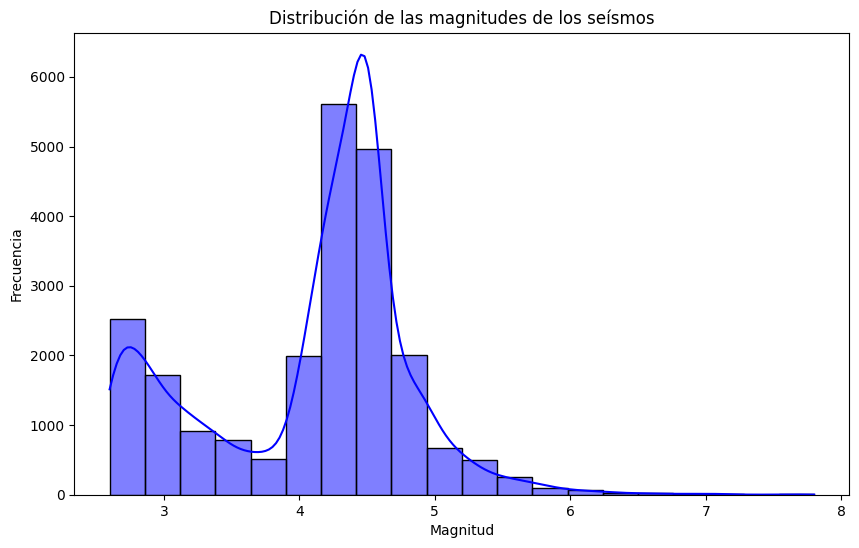

In [23]:
# Histograma de magnitudes
# Se utiliza una estimación de la densidad kernel (KDE) para representar la línea de tendencia
plt.figure(figsize=(10,6))
sns.histplot(df['mag'], bins=20, kde=True, color='blue', edgecolor='black')
plt.title('Distribución de las magnitudes de los seísmos')
plt.xlabel('Magnitud')
plt.ylabel('Frecuencia')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


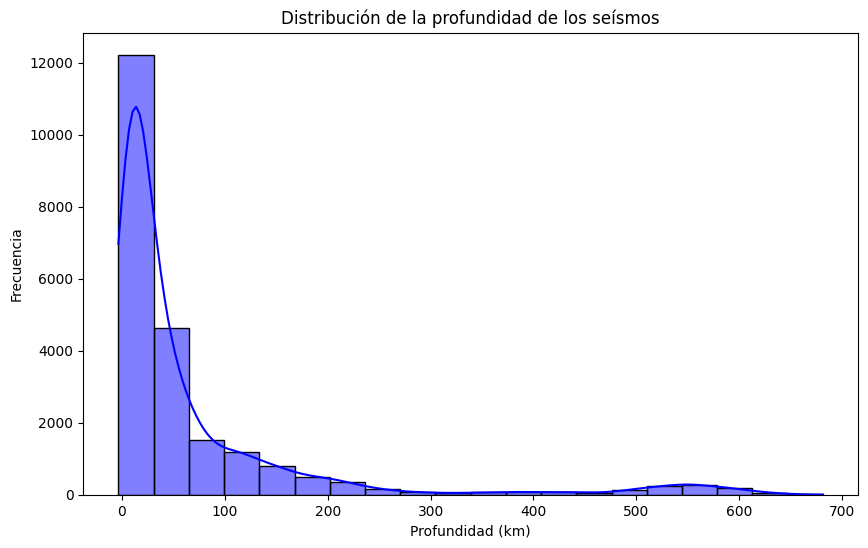

In [24]:
# Histograma de profundidad de los seísmos
plt.figure(figsize=(10, 6))
sns.histplot(df['depth'], bins=20, kde=True, color='Blue', edgecolor='black')
plt.title('Distribución de la profundidad de los seísmos')
plt.xlabel('Profundidad (km)')
plt.ylabel('Frecuencia')
plt.show()

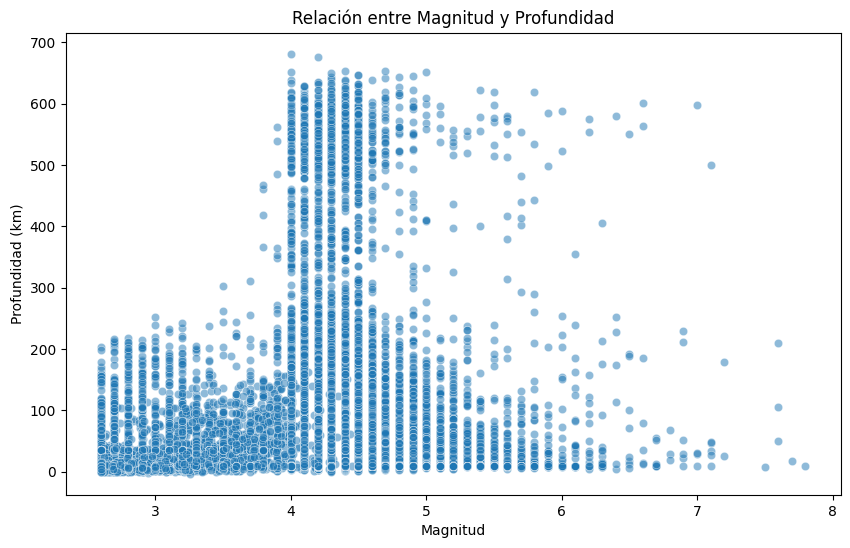

In [25]:
# Diagrama dispersión magnitud vs profundidad
plt.figure(figsize=(10, 6))
sns.scatterplot(x='mag', y='depth', data=df, alpha=0.5)
plt.title('Relación entre Magnitud y Profundidad')
plt.xlabel('Magnitud')
plt.ylabel('Profundidad (km)')
plt.show()

## **2. Análisis geoespacial**
### **Utilizamos las bibliotecas geopandas y folium para representar la distribución de los seísmos en todo el planeta:**

/tmp/ipykernel_26/2024912841.py:4: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  mapamundi = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


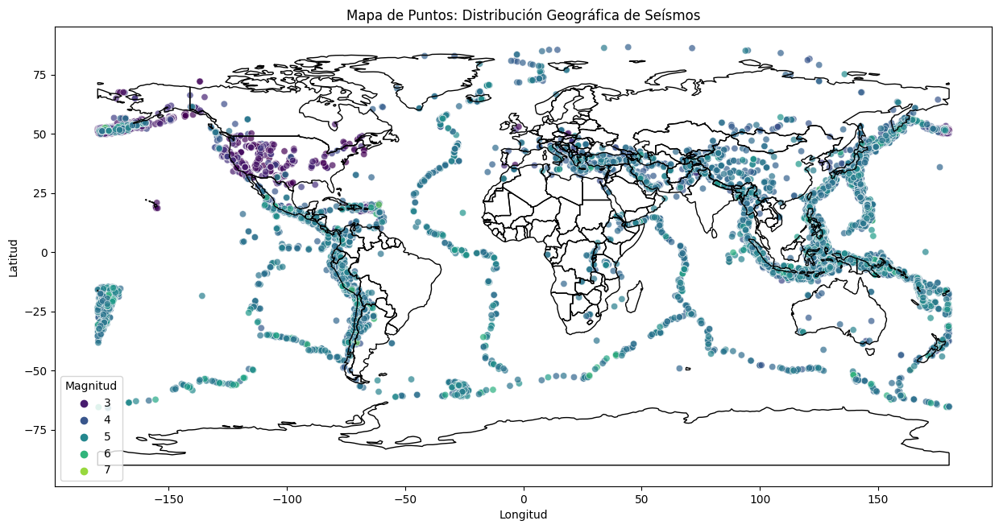

In [26]:
import geopandas as gpd

# Cargar los límites mapamundi usando geopandas
mapamundi = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Gráfico de puntos con seaborn sobre el mapamundi
plt.figure(figsize=(15, 10))
ax = sns.scatterplot(x='longitude', y='latitude', data=df, hue='mag', palette='viridis', legend='brief', alpha=0.7)
mapamundi.boundary.plot(ax=ax, linewidth=1, color='black')  # Agregar límites del mundo

plt.title('Mapa de Puntos: Distribución Geográfica de Seísmos')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.legend(title='Magnitud')
plt.show()

In [27]:
import folium

# Mapa interactivo con folium
mapamundi_folium = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=3)
for index, row in df.iterrows():
    info_popup = f"Mag: {row['mag']}, Profundidad: {row['depth']} km, Lugar: {row['place']}"
    folium.Marker([row['latitude'], row['longitude']], popup=info_popup).add_to(mapamundi_folium)
mapamundi_folium

## **3. Análisis temporal**
### **Analizamos la frecuencia de los seísmos durante todo el año 2023:**

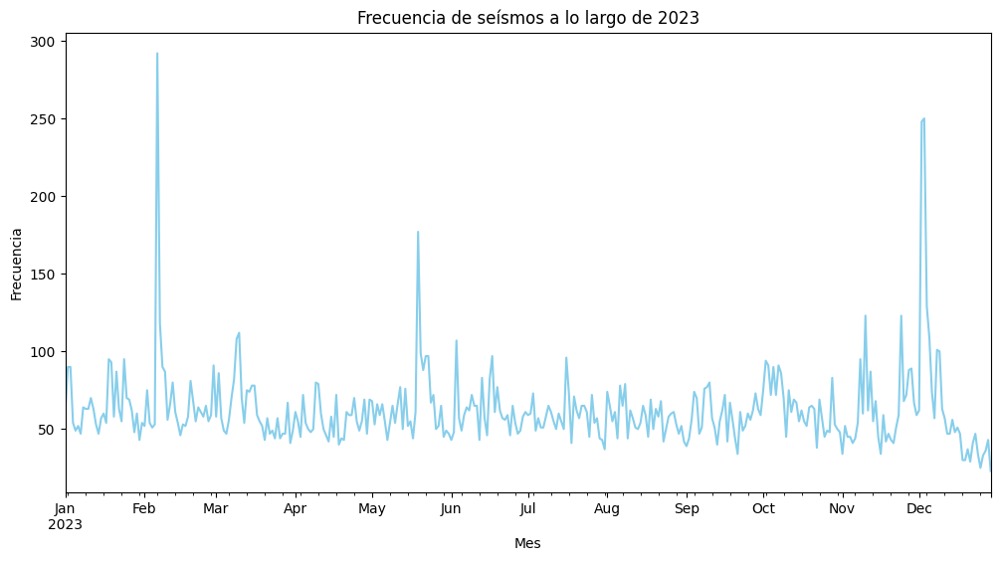

In [28]:
# Gráfico frecuencia seísmos año 2023
frecuencia_mensual = df.resample('D', on='time').size()
plt.figure(figsize=(12, 6))
frecuencia_mensual.plot(kind='line', color='skyblue')
plt.title('Frecuencia de seísmos a lo largo de 2023')
plt.xlabel('Mes')
plt.ylabel('Frecuencia')
plt.show()

### **Exploramos el comportamiento de la serie temporal con la descomposición en los componentes principales: tendencia, estacionalidad y residuos**

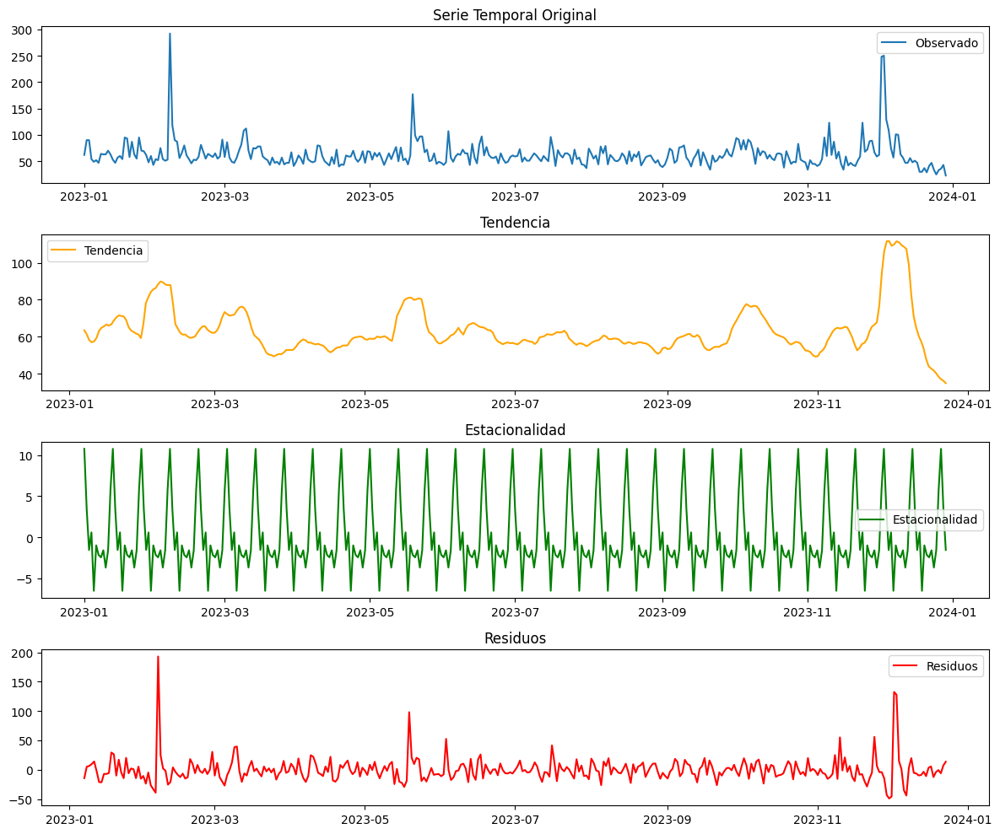

In [29]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Descomposición de la serie temporal
series = seasonal_decompose(frecuencia_mensual, model='additive', period=12)

plt.figure(figsize=(12, 10))

# Gráfico de la serie observada
plt.subplot(4, 1, 1)
plt.plot(series.observed, label='Observado')
plt.legend()
plt.title('Serie Temporal Original')

# Gráfico de la tendencia
plt.subplot(4, 1, 2)
plt.plot(series.trend, label='Tendencia', color='orange')
plt.legend()
plt.title('Tendencia')

# Gráfico de la estacionalidad
plt.subplot(4, 1, 3)
plt.plot(series.seasonal, label='Estacionalidad', color='green')
plt.legend()
plt.title('Estacionalidad')

# Gráfico de los residuos
plt.subplot(4, 1, 4)
plt.plot(series.resid, label='Residuos', color='red')
plt.legend()
plt.title('Residuos')

plt.tight_layout()
plt.show()

## **4. Análisis de las estaciones de detección sísmica**
### **Distribución de las fuentes que se usan en la detección de los seísmos:**
- **us**: United States Geological Survey (USGS)
- **pr**: Puerto Rico Seismic Network
- **nc**: Northern California Seismic System
- **tx**: University of Texas at Austin
- **ci**: Caltech/USGS Sourthern California Seismic Network
- **uu**: University of Utah Seismograph Stations
- **se**: European-Mediterranean Seismological Centre (EMSC)
- **nm**: New Madrid Seismic Zone
- **uw**: University of Washington, Pacific Northwest Seismic Network

In [30]:
df['locationSource'].unique()

array(['us', 'pr', 'nc', 'tx', 'ci', 'uu', 'se', 'nm', 'uw'], dtype=object)

In [31]:
df['magSource'].unique()

array(['us', 'pr', 'nc', 'tx', 'ci', 'uu', 'se', 'nm', 'uw'], dtype=object)

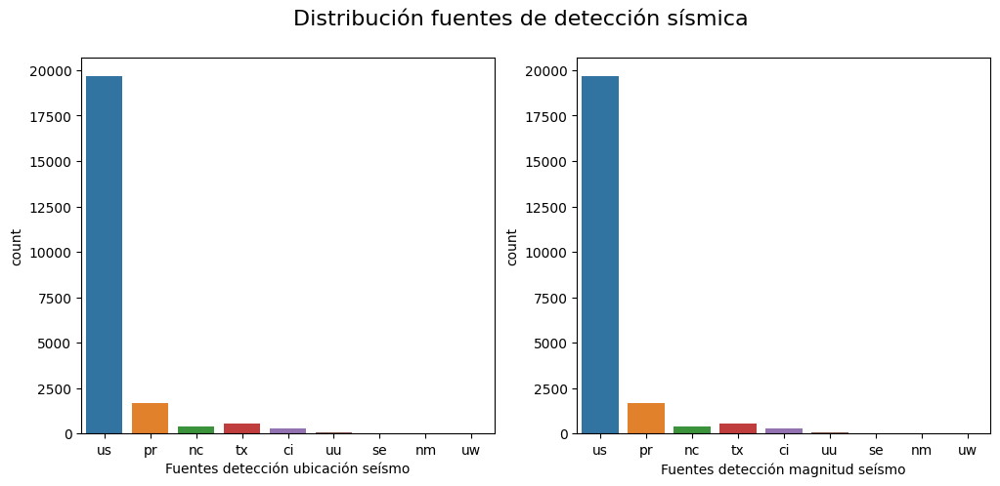

In [32]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

sns.countplot(x='locationSource', data=df, ax=axes[0])
axes[0].set_xlabel('Fuentes detección ubicación seísmo')

sns.countplot(x='magSource', data=df, ax=axes[1])
axes[1].set_xlabel('Fuentes detección magnitud seísmo')

fig.suptitle('Distribución fuentes de detección sísmica', fontsize=16)
plt.show()

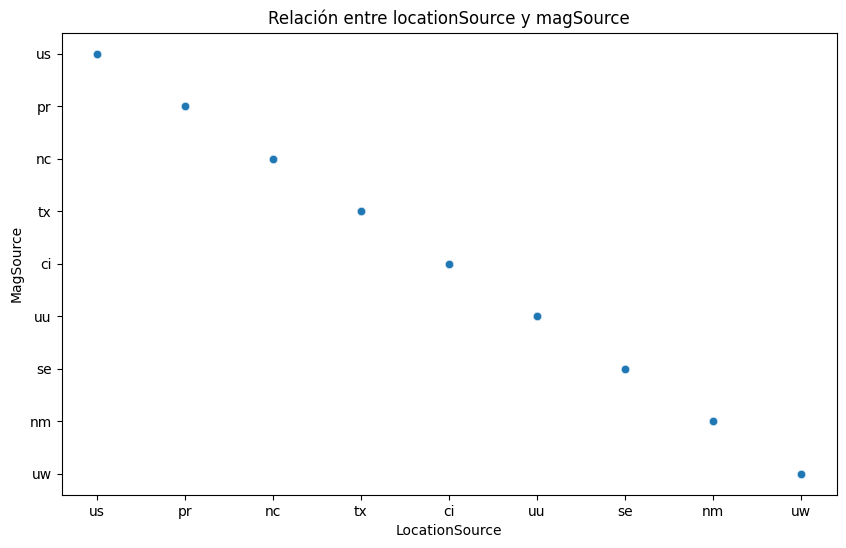

In [33]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='locationSource', y='magSource', data=df, alpha=0.7)
plt.title('Relación entre locationSource y magSource')
plt.xlabel('LocationSource')
plt.ylabel('MagSource')
plt.show()

### **Número de estaciones sísmicas que detectaron la localización y magnitud de los seísmos:**

In [34]:
from IPython.display import display

# Formato fecha YYYY-MM-DD
df['date'] = df['time'].dt.strftime('%Y-%m-%d')

# Seísmos detectados por más estaciones sísmicas
seismos_max_nst = df.sort_values(by='nst', ascending=False).head(5)
print("Seísmos detectados por más estaciones:")
display(seismos_max_nst[['date', 'depth', 'mag', 'nst', 'magNst', 'place']])

# Seísmos detectados por menos estaciones sísmicas
seismos_min_nst = df.sort_values(by='nst').head(5)
print("\nSeísmos detectados por menos estaciones:")
display(seismos_min_nst[['date', 'depth', 'mag', 'nst', 'magNst', 'place']])

# Magnitud de seísmos detectada por más estaciones sísmicas
seismos_max_magNst = df.sort_values(by='magNst', ascending=False).head(5)
print("\nMagnitud de seísmos detectada por más estaciones:")
display(seismos_max_magNst[['date', 'depth', 'mag', 'nst', 'magNst', 'place']])

# Magnitud de seísmos detectada por menos estaciones sísmicas
seismos_min_magNst = df.sort_values(by='magNst').head(5)
print("\nMagnitud de seísmos detectada por menos estaciones:")
display(seismos_min_magNst[['date', 'depth', 'mag', 'nst', 'magNst', 'place']])

Seísmos detectados por más estaciones:


,date,depth,mag,nst,magNst,place
24678,2023-10-11,8.0,6.3,423.0,49.0,"24 km NNW of Herāt, Afghanistan"
23104,2023-07-16,25.0,7.2,410.0,156.0,"106 km S of Sand Point, Alaska"
26553,2023-12-23,29.0,5.8,410.0,47.0,"115 km SSE of Vilyuchinsk, Russia"
24943,2023-10-26,10.0,5.9,388.0,99.0,"143 km E of Ust’-Kamchatsk Staryy, Russia"
21762,2023-05-10,210.0,7.6,380.0,32.0,"82 km WNW of Hihifo, Tonga"



Seísmos detectados por menos estaciones:


,date,depth,mag,nst,magNst,place
6498,2023-04-27,4.85,2.74,3.0,2.0,Puerto Rico region
13288,2023-09-03,7.68,3.34,3.0,3.0,"64 km NE of Cruz Bay, U.S. Virgin Islands"
9974,2023-06-30,90.00,3.84,3.0,2.0,Puerto Rico region
19186,2023-12-28,80.33,3.27,3.0,4.0,"66 km E of Cruz Bay, U.S. Virgin Islands"
4326,2023-03-15,5.72,2.67,3.0,2.0,Puerto Rico region



Magnitud de seísmos detectada por más estaciones:


,date,depth,mag,nst,magNst,place
25190,2023-11-08,77.731,5.6,126.0,884.0,Kuril Islands
21138,2023-04-05,560.074,5.1,128.0,814.0,"156 km SSW of Tarauacá, Brazil"
24731,2023-10-13,168.306,5.1,214.0,796.0,"30 km WSW of Imabetsu, Japan"
20901,2023-03-20,215.062,4.9,135.0,678.0,"111 km NNW of Nikolski, Alaska"
21546,2023-04-28,587.560,6.0,113.0,676.0,south of the Fiji Islands



Magnitud de seísmos detectada por menos estaciones:


,date,depth,mag,nst,magNst,place
13608,2023-09-09,86.355,3.9,9.0,1.0,"92 km S of La Tirana, Chile"
2972,2023-02-20,99.369,4.1,16.0,1.0,"108 km S of Calama, Chile"
10753,2023-07-15,10.000,4.1,27.0,1.0,North Atlantic Ocean
2146,2023-02-06,10.000,4.2,19.0,1.0,"10 km SSW of Çelikhan, Turkey"
18926,2023-12-19,10.000,3.7,10.0,1.0,"7 km WNW of San Marcos, Costa Rica"


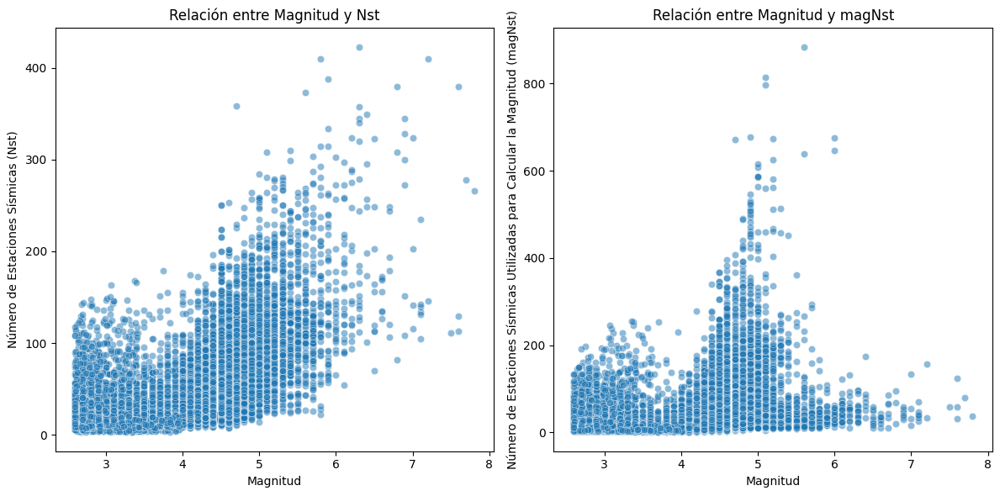

In [35]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.scatterplot(x='mag', y='nst', data=df, alpha=0.5)
plt.title('Relación entre Magnitud y Nst')
plt.xlabel('Magnitud')
plt.ylabel('Número de Estaciones Sísmicas (Nst)')

plt.subplot(1, 2, 2)
sns.scatterplot(x='mag', y='magNst', data=df, alpha=0.5)
plt.title('Relación entre Magnitud y magNst')
plt.xlabel('Magnitud')
plt.ylabel('Número de Estaciones Sísmicas Utilizadas para Calcular la Magnitud (magNst)')

plt.tight_layout()
plt.show()

## **5. Análisis de los errores en la medición**

In [36]:
# Estadísticas descriptivas de las columnas relacionadas con errores
errores = df[['horizontalError', 'depthError', 'magError']].describe()
print(errores.round(3))

       horizontalError  depthError   magError
count        22691.000   22691.000  22691.000
mean             7.118       4.791      0.119
std              4.004       4.464      0.057
min              0.000       0.100      0.000
25%              4.300       1.881      0.080
50%              7.150       2.961      0.109
75%              9.750       6.962      0.148
max             99.000      47.878      0.770


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


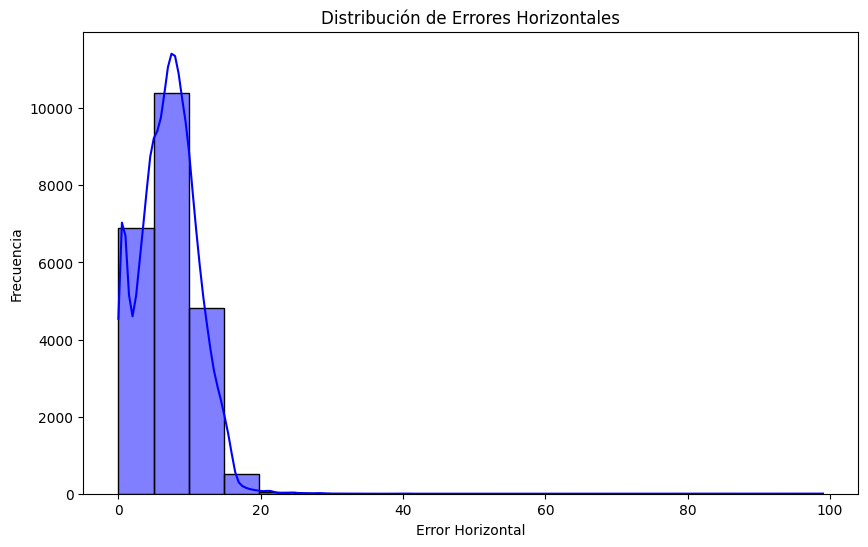

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


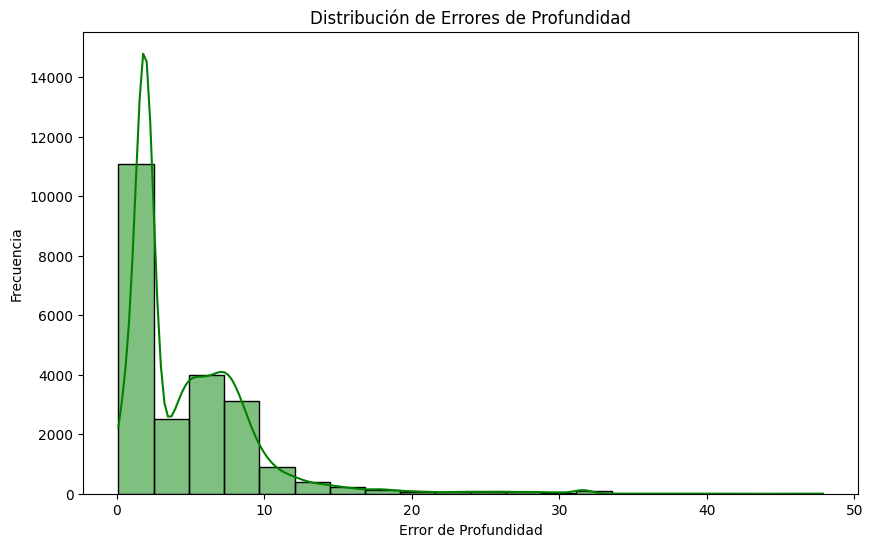

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


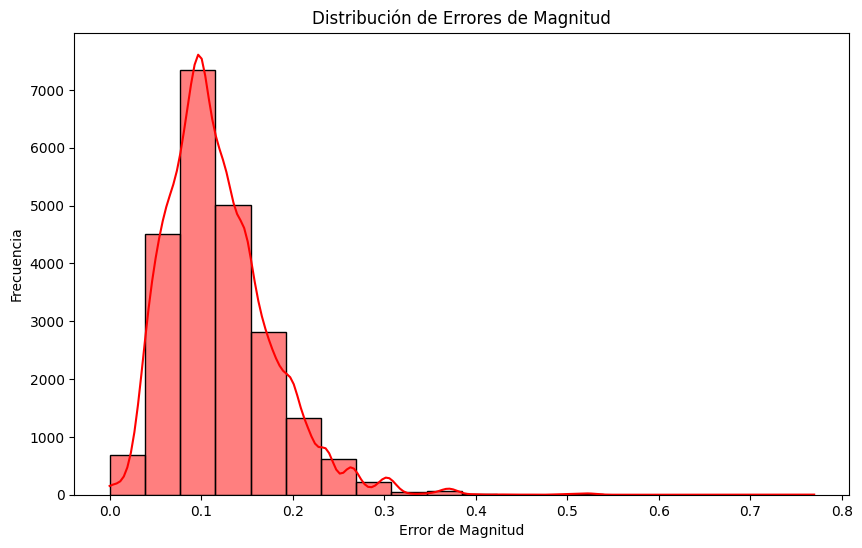

In [37]:
# Histograma de errores horizontales
plt.figure(figsize=(10, 6))
sns.histplot(df['horizontalError'], bins=20, kde=True, color='blue', edgecolor='black')
plt.title('Distribución de Errores Horizontales')
plt.xlabel('Error Horizontal')
plt.ylabel('Frecuencia')
plt.show()

# Histograma de errores de profundidad
plt.figure(figsize=(10, 6))
sns.histplot(df['depthError'], bins=20, kde=True, color='green', edgecolor='black')
plt.title('Distribución de Errores de Profundidad')
plt.xlabel('Error de Profundidad')
plt.ylabel('Frecuencia')
plt.show()

# Histograma de errores de magnitud
plt.figure(figsize=(10, 6))
sns.histplot(df['magError'], bins=20, kde=True, color='red', edgecolor='black')
plt.title('Distribución de Errores de Magnitud')
plt.xlabel('Error de Magnitud')
plt.ylabel('Frecuencia')
plt.show()

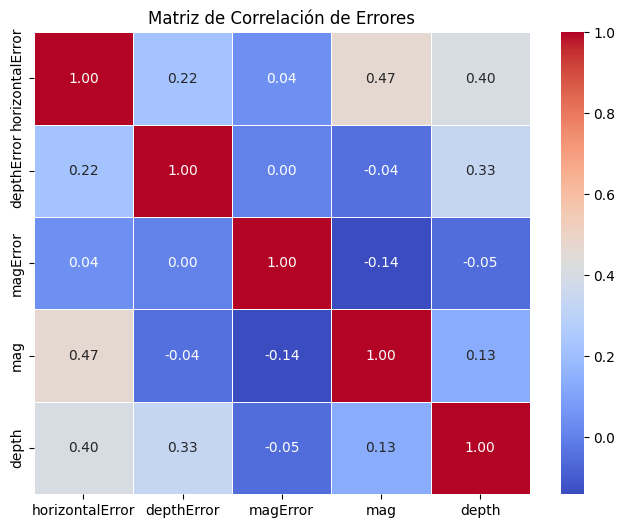

In [38]:
# Matriz de correlación
matriz_correlacion = df[['horizontalError', 'depthError', 'magError', 'mag', 'depth']].corr()

# Visualización de la matriz de correlación
plt.figure(figsize=(8, 6))
sns.heatmap(matriz_correlacion, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Matriz de Correlación de Errores')
plt.show()

# 📈 **Modelado**
## **6. Modelos de machine learning**
### **Regresión lineal**

In [39]:
time_numeric = pd.Series(df['time'].astype(int))

df['time_numeric'] = time_numeric

In [40]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Dividir los datos en características (X) y la variable objetivo (y)
X = df[['time_numeric', 'latitude', 'longitude', 'depth']]  # Características
y = df['mag']  # Variable objetivo

# Dividir los datos en conjuntos de entrenamiento y prueba (80% entrenamiento, 20% prueba)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenar un modelo de regresión lineal
modelo_reg_lineal = LinearRegression()
modelo_reg_lineal.fit(X_train, y_train)

# Realizar predicciones en el conjunto de prueba
predicciones_reg_lineal = modelo_reg_lineal.predict(X_test)

# Calcular el error cuadrático medio (MSE) en el conjunto de prueba
mse_reg_lineal = mean_squared_error(y_test, predicciones_reg_lineal)
print("Error Cuadrático Medio (Regresión Lineal):", mse_reg_lineal)

Error Cuadrático Medio (Regresión Lineal): 0.3252362286788169


### **KNN**

In [41]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

# Definir los parámetros a probar
parametros_knn = {'n_neighbors': range(1, 21)}  # desde 1 hasta 20 inclusive

# Crear el modelo KNN
knn_model = KNeighborsRegressor()

# Crear el objeto GridSearchCV
grid_search_knn = GridSearchCV(knn_model, parametros_knn, cv=5, scoring='neg_mean_squared_error')

# Entrenar el modelo
grid_search_knn.fit(X_train, y_train)

# Obtener el mejor modelo
mejor_modelo_knn = grid_search_knn.best_estimator_

# Hacer predicciones con el mejor modelo
predicciones_mejor_knn = mejor_modelo_knn.predict(X_test)

# Calcular el MSE del mejor modelo
mse_mejor_knn = mean_squared_error(y_test, predicciones_mejor_knn)
print("Mejor modelo KNN - MSE:", mse_mejor_knn)

Mejor modelo KNN - MSE: 0.5623137435435428


### **Random Forest**

In [42]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV

# Definir el rango de valores para el parámetro de profundidad
param_grid = {'max_depth': range(1, 11)}

# Inicializar el modelo de Bosque Aleatorio
rf_regressor = RandomForestRegressor(random_state=42)

# Inicializar GridSearchCV
grid_search = GridSearchCV(estimator=rf_regressor, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')

# Entrenar GridSearchCV
grid_search.fit(X_train, y_train)

# Obtener el mejor estimador
best_rf_regressor = grid_search.best_estimator_
print("Mejor estimador de Bosque Aleatorio:", best_rf_regressor)

# Realizar predicciones sobre el conjunto de prueba utilizando el mejor estimador
y_pred = best_rf_regressor.predict(X_test)

# Calcular el error cuadrático medio (MSE)
mse_rf = mean_squared_error(y_test, y_pred)
print("Error cuadrático medio (MSE):", mse_rf)

Mejor estimador de Bosque Aleatorio: RandomForestRegressor(max_depth=10, random_state=42)
Error cuadrático medio (MSE): 0.14090278963560668


### **XGBoost**

In [43]:
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

# Definir los parámetros a probar
parametros_xgb = {
    'max_depth': [3, 7],  # Profundidad máxima del árbol
    'learning_rate': [0.01, 0.1, 0.3],  # Tasa de aprendizaje
    'n_estimators': [100, 200, 300]  # Número de árboles a utilizar
}

# Crear el modelo XGBoost
xgb_model = xgb.XGBRegressor()

# Crear el objeto GridSearchCV para buscar los mejores hiperparámetros
grid_search_xgb = GridSearchCV(xgb_model, parametros_xgb, cv=5, scoring='neg_mean_squared_error')

# Entrenar el modelo
grid_search_xgb.fit(X_train, y_train)

# Obtener el mejor modelo XGBoost
mejor_modelo_xgb = grid_search_xgb.best_estimator_
print("Mejor modelo XGBoost:", mejor_modelo_xgb)

# Realizar predicciones sobre el conjunto de prueba utilizando el mejor modelo
y_pred_xgb = mejor_modelo_xgb.predict(X_test)

# Calcular el error cuadrático medio (MSE) del mejor modelo
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
print("Error cuadrático medio (MSE) del mejor modelo XGBoost:", mse_xgb)

Mejor modelo XGBoost: XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=7, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)
Error cuadrático medio (MSE) del mejor modelo XGBoost: 0.14109659489370033


## **7. Modelos de redes neuronales**

In [44]:
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import mean_squared_error

from sklearn.preprocessing import StandardScaler

# Escalar los datos para mejorar el rendimiento de la red neuronal
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Definir la arquitectura de la red neuronal
model = keras.Sequential([
    keras.layers.Dense(64, activation='relu', input_shape=[X_train.shape[1]]),
    keras.layers.Dense(32, activation='relu'),
    keras.layers.Dense(1)  
])

# Compilar el modelo
model.compile(optimizer='adam', loss='mean_squared_error')

# Resumen arquitectura modelo
model.summary()

# Entrenar el modelo
history_nn = model.fit(X_train_scaled, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Evaluar el modelo en el conjunto de prueba
y_pred_nn = model.predict(X_test_scaled)
mse_nn = mean_squared_error(y_test, y_pred_nn)
print("Error cuadrático medio (MSE) de la red neuronal:", mse_nn)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                320       
                                                                 
 dense_1 (Dense)             (None, 32)                2080      
                                                                 
 dense_2 (Dense)             (None, 1)                 33        
                                                                 
Total params: 2433 (9.50 KB)
Trainable params: 2433 (9.50 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/100
454/454 [==============================] - 4s 4ms/step - loss: 1.4418 - val_loss: 0.3852
Epoch 2/100
454/454 [==============================] - 1s 3ms/step - loss: 0.3018 - val_loss: 0.2658
Epoch 3/100
454/454 [==============================] - 1s 3ms/step - loss: 0.2429 - va

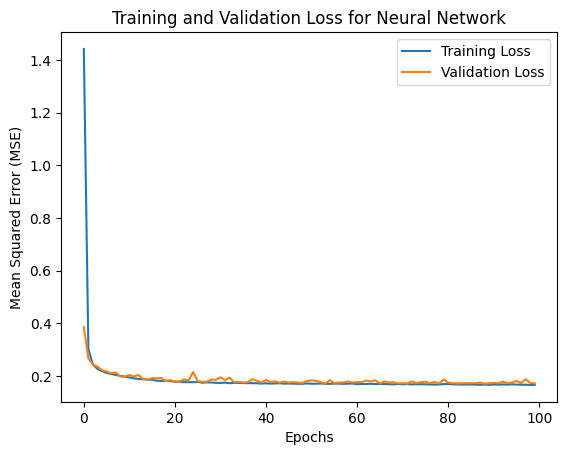

In [45]:
# Grafica de la pérdida (MSE) en entrenamiento y test para la red neuronal
plt.plot(history_nn.history['loss'], label='Training Loss')
plt.plot(history_nn.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss for Neural Network')
plt.xlabel('Epochs')
plt.ylabel('Mean Squared Error (MSE)')
plt.legend()
plt.show()

### **Red Neuronal Recurrente (RNN) - LSTM**

In [46]:
from keras.models import Sequential
from keras.layers import LSTM, Dense

# Definir la arquitectura del modelo LSTM
modelo_lstm = Sequential()
modelo_lstm.add(LSTM(units=64, activation='relu', input_shape=(X_train_scaled.shape[1], 1)))
modelo_lstm.add(Dense(units=32, activation='relu'))
modelo_lstm.add(Dense(units=1))  

# Compilar el modelo
modelo_lstm.compile(optimizer='adam', loss='mean_squared_error')

# Resumen arquitectura modelo
modelo_lstm.summary()

# Entrenar el modelo
history_lstm = modelo_lstm.fit(X_train_scaled.reshape((X_train_scaled.shape[0], X_train_scaled.shape[1], 1)), 
                                y_train, epochs=100, batch_size=32, validation_split=0.2)

# Calcular las predicciones en el conjunto de prueba
predicciones_lstm = modelo_lstm.predict(X_test_scaled.reshape((X_test_scaled.shape[0], X_test_scaled.shape[1], 1)))

# Calcular el error cuadrático medio (MSE)
mse_lstm = mean_squared_error(y_test, predicciones_lstm)
print("Error cuadrático medio (MSE) del modelo LSTM:", mse_lstm)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 64)                16896     
                                                                 
 dense_3 (Dense)             (None, 32)                2080      
                                                                 
 dense_4 (Dense)             (None, 1)                 33        
                                                                 
Total params: 19009 (74.25 KB)
Trainable params: 19009 (74.25 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/100
454/454 [==============================] - 7s 10ms/step - loss: 1.7126 - val_loss: 0.4699
Epoch 2/100
454/454 [==============================] - 4s 10ms/step - loss: 0.3931 - val_loss: 0.3282
Epoch 3/100
454/454 [==============================] - 4s 10ms/step - loss: 0.

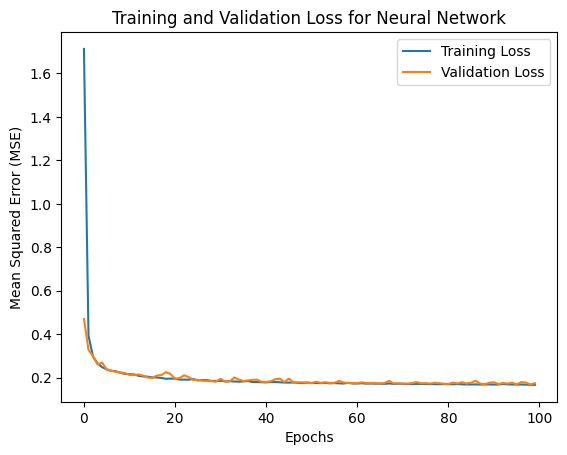

In [47]:
# Grafica de la pérdida (MSE) en entrenamiento y test para la red neuronal
plt.plot(history_lstm.history['loss'], label='Training Loss')
plt.plot(history_lstm.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss for Neural Network')
plt.xlabel('Epochs')
plt.ylabel('Mean Squared Error (MSE)')
plt.legend()
plt.show()

### **Tabla comparativa MSE**

In [48]:
# Crear un DataFrame con los resultados de MSE de cada modelo
resultados_mse = {
    'Modelo': ['Regresión Lineal', 'KNN', 'Random Forest', 'XGBoost', 'Red Neuronal', 'LSTM'],
    'MSE': [mse_reg_lineal, mse_mejor_knn, mse_rf, mse_xgb, mse_nn, mse_lstm]
}

df_resultados = pd.DataFrame(resultados_mse)

# Mostrar la tabla comparativa
print("Tabla comparativa de MSE de cada modelo:")
print(df_resultados)

Tabla comparativa de MSE de cada modelo:
             Modelo       MSE
0  Regresión Lineal  0.325236
1               KNN  0.562314
2     Random Forest  0.140903
3           XGBoost  0.141097
4      Red Neuronal  0.165067
5              LSTM  0.166631
